# <font color='green'> **Digital Diet - Predicting Wellness**

### Overview

> The relationship between digital consumption habits & wellness.

* Main metric: Weekly_anxiety_score. Integers from 0-20. A high score is a good score. 20 is the best possible score.

* Target variable (y) is if a participant has a Good anxiety score (11-20), or not.

---

### Contents

<font color='green'> Cleaning </font>
* Nulls
* Data types
* Duplicates
* Distribution/spread (histogram)
* Outliers & quartiles (boxplot)
* Handling erroneous outliers & features

<font color='green'> EDA </font>
* Introduce new columns & target variable
* Observe feature relationships (pairplot)
* Explore categorical/demographic/boolean features (5)
* Explore numerical features (12)

<font color='green'> Transforming data </font>
* One-hot encoding
* Standardization

<font color='green'> Predictive Modelling </font>
* k-Nearest Neighbors
* Random Forest

<font color='green'> Comparative analysis </font>
* Accuracy, Precision, Recall, F1 scores

<font color='green'> Performance analysis </font>
* Feature importance

---

In [53]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import iqr

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.ensemble import RandomForestClassifier

%matplotlib inline

In [2]:
digital_diet = pd.read_csv('./dataset/digital_diet_mental_health.csv')
digital_diet.head()

,user_id,age,gender,daily_screen_time_hours,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,...,stress_level,physical_activity_hours_per_week,location_type,mental_health_score,uses_wellness_apps,eats_healthy,caffeine_intake_mg_per_day,weekly_anxiety_score,weekly_depression_score,mindfulness_minutes_per_day
0,user_1,51,Female,4.8,3.4,1.3,1.6,1.6,4.1,2.0,...,10,0.7,Urban,32,1,1,125.2,13,15,4.0
1,user_2,64,Male,3.9,3.5,1.8,0.9,2.0,2.7,3.1,...,6,4.3,Suburban,75,0,1,150.4,19,18,6.5
2,user_3,41,Other,10.5,2.1,2.6,0.7,2.2,3.0,2.8,...,5,3.1,Suburban,22,0,0,187.9,7,3,6.9
3,user_4,27,Other,8.8,0.0,0.0,0.7,2.5,3.3,1.6,...,5,0.0,Rural,22,0,1,73.6,7,2,4.8
4,user_5,55,Male,5.9,1.7,1.1,1.5,1.6,1.1,3.6,...,7,3.0,Urban,64,1,1,217.5,8,10,0.0


In [3]:
print(digital_diet.shape)
print(f"Before cleaning there are {digital_diet.shape[0]} rows (unique participants) & {digital_diet.shape[1]} columns.")

(2000, 25)
Before cleaning there are 2000 rows (unique participants) & 25 columns.


---

---

# <font color='green'> Cleaning

### Check Nulls

In [4]:
digital_diet.isnull().sum().sort_values(ascending=False).head()

user_id                    0
age                        0
gender                     0
daily_screen_time_hours    0
phone_usage_hours          0
dtype: int64

### Check Data types

In [5]:
digital_diet.dtypes

user_id                              object
age                                   int64
gender                               object
daily_screen_time_hours             float64
phone_usage_hours                   float64
laptop_usage_hours                  float64
tablet_usage_hours                  float64
tv_usage_hours                      float64
social_media_hours                  float64
work_related_hours                  float64
entertainment_hours                 float64
gaming_hours                        float64
sleep_duration_hours                float64
sleep_quality                         int64
mood_rating                           int64
stress_level                          int64
physical_activity_hours_per_week    float64
location_type                        object
mental_health_score                   int64
uses_wellness_apps                    int64
eats_healthy                          int64
caffeine_intake_mg_per_day          float64
weekly_anxiety_score            

### Check Duplicates (by id)

In [6]:
digital_diet['user_id'].value_counts().sort_values(ascending=False).head()

user_id
user_1    1
user_2    1
user_3    1
user_4    1
user_5    1
Name: count, dtype: int64

### Check Distribution/Spread with histograms

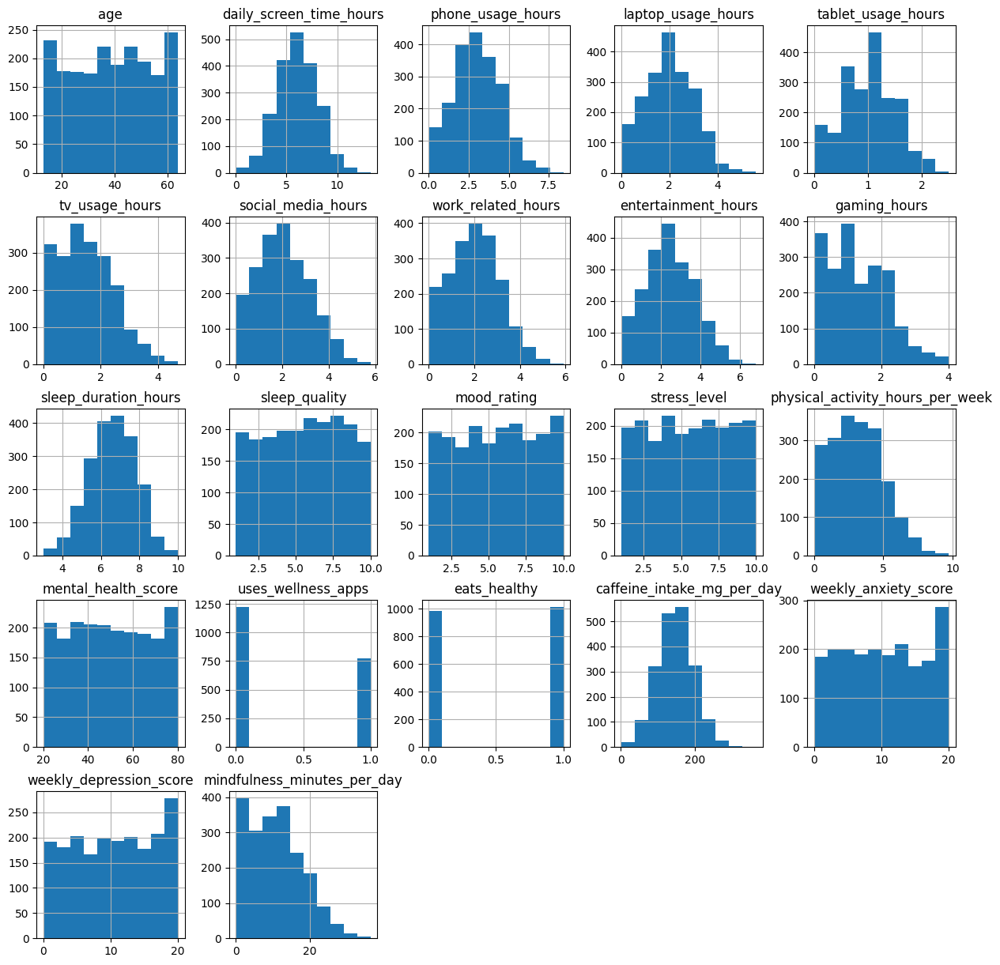

In [7]:
digital_diet.hist(figsize=(15,15));

Quite a few skewed by outliers. Need further investigation.

### Check Outliers with boxplots (after Distribution/Spread)

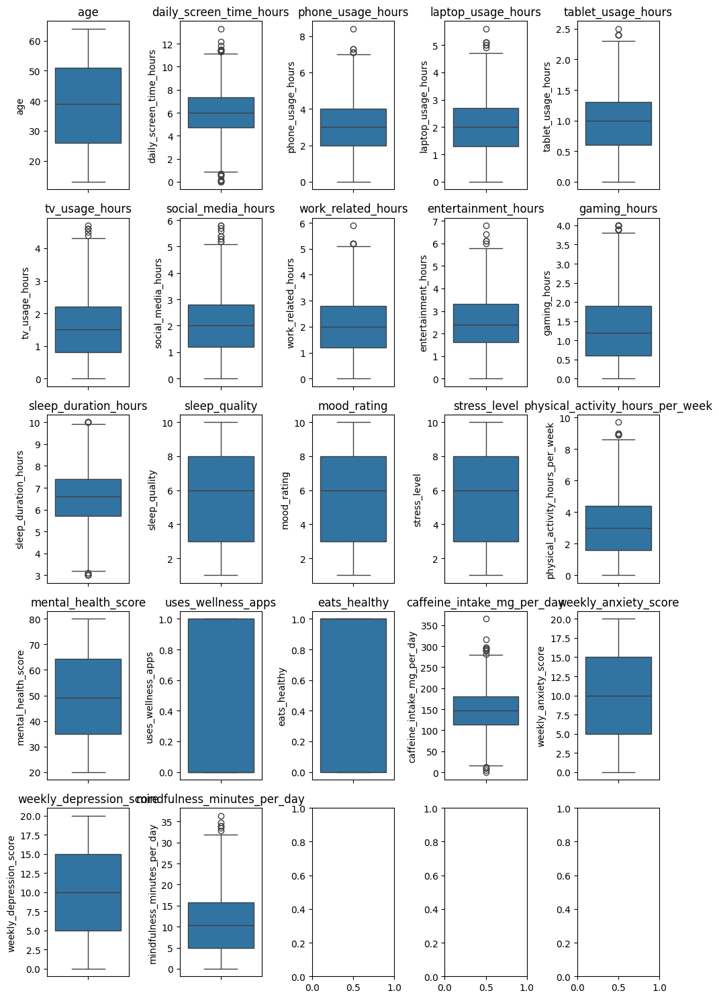

In [8]:
digital_diet_boxplots = pd.DataFrame(digital_diet)
numeric_cols = digital_diet_boxplots.select_dtypes(include=['number']).columns
fig, axes = plt.subplots(nrows=5, ncols=5, figsize=(10, 15))
for ax, col in zip(axes.flatten(), numeric_cols):
    sns.boxplot(y=digital_diet_boxplots[col], ax=ax)
    ax.set_title(col)
plt.tight_layout()
plt.show()

### Further isolate/inspect Outliers with describe (comparing quartiles & thresholds)

In [9]:
digital_diet.drop(['age', 'sleep_quality', 'mood_rating', 'stress_level', 'mental_health_score', 'uses_wellness_apps', 'eats_healthy', 'weekly_anxiety_score', 'weekly_depression_score'], axis=1).describe()

,daily_screen_time_hours,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,entertainment_hours,gaming_hours,sleep_duration_hours,physical_activity_hours_per_week,caffeine_intake_mg_per_day,mindfulness_minutes_per_day
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.00000,2000.0000,2000.000000,2000.000000,2000.00000,2000.000000
mean,6.025600,3.023700,1.999950,0.995650,1.503700,2.039200,2.010250,2.46735,1.2795,6.537550,3.087150,148.07970,10.753750
std,1.974123,1.449399,0.997949,0.492714,0.959003,1.133435,1.116111,1.23686,0.8945,1.203856,1.885258,48.86066,7.340269
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.0000,3.000000,0.000000,0.80000,0.000000
25%,4.700000,2.000000,1.300000,0.600000,0.800000,1.200000,1.200000,1.60000,0.6000,5.700000,1.600000,113.90000,4.900000
50%,6.000000,3.000000,2.000000,1.000000,1.500000,2.000000,2.000000,2.40000,1.2000,6.600000,3.000000,147.45000,10.400000
75%,7.325000,4.000000,2.700000,1.300000,2.200000,2.800000,2.800000,3.30000,1.9000,7.400000,4.400000,180.70000,15.800000
max,13.300000,8.400000,5.600000,2.500000,4.700000,5.800000,5.900000,6.80000,4.0000,10.000000,9.700000,364.90000,36.400000


### Handling erroneous outliers

After extensive checks, the outliers are mostly from columns/features measuring metrics like time. Decision made to remove them as these are core metrics to compare/contrast with main metric.

In [10]:
qr = []
col_data = digital_diet.columns[[4, 5, 6, 7, 8, 9, 10, 11, 12, 16, 21, 24]]

for x in col_data:
    col_values = digital_diet[x]
    iqrc = iqr(col_values)
    lower_threshold = np.quantile(col_values, 0.25) - 1.5 * iqrc
    upper_threshold = np.quantile(col_values, 0.75) + 1.5 * iqrc
    qr.append((x, lower_threshold, upper_threshold))

print(qr) # Check thresholds before removal 

[('phone_usage_hours', np.float64(-1.0), np.float64(7.0)), ('laptop_usage_hours', np.float64(-0.8), np.float64(4.800000000000001)), ('tablet_usage_hours', np.float64(-0.45000000000000007), np.float64(2.35)), ('tv_usage_hours', np.float64(-1.3), np.float64(4.300000000000001)), ('social_media_hours', np.float64(-1.2), np.float64(5.199999999999999)), ('work_related_hours', np.float64(-1.2), np.float64(5.199999999999999)), ('entertainment_hours', np.float64(-0.9499999999999997), np.float64(5.85)), ('gaming_hours', np.float64(-1.3499999999999996), np.float64(3.8499999999999996)), ('sleep_duration_hours', np.float64(3.15), np.float64(9.950000000000001)), ('physical_activity_hours_per_week', np.float64(-2.6), np.float64(8.600000000000001)), ('caffeine_intake_mg_per_day', np.float64(13.700000000000031), np.float64(280.9)), ('mindfulness_minutes_per_day', np.float64(-11.450000000000001), np.float64(32.150000000000006))]


In [11]:
for col, lower, upper in qr:
    digital_diet = digital_diet[(digital_diet[col] >= lower) & (digital_diet[col] <= upper)]

### Dropping erroneous columns

After further checks on data dictionary. The "daily_screen_time_hours" column/feature is inconsistent & hard to interpret. Decision to drop.

In [12]:
digital_diet = digital_diet.drop(columns=['daily_screen_time_hours'])

### Cleaning report

In [13]:
print(digital_diet.shape)
print(f"After cleaning there are {digital_diet.shape[0]} rows (unique participants) & {digital_diet.shape[1]} columns.")

(1915, 24)
After cleaning there are 1915 rows (unique participants) & 24 columns.


---

---

# <font color='green'> Exploratory Data Analysis (EDA)

### Anxiety categorization & target variable (as defined in introduction)

In [14]:
def anxiety_categorization(row):
    if row['weekly_anxiety_score'] < 7:
        return 'Low anxiety score'
    elif row['weekly_anxiety_score'] > 13:
        return 'High anxiety score'
    else:
        return 'Medium anxiety score'
    
digital_diet['anxiety_cat'] = digital_diet.apply(anxiety_categorization, axis=1)

In [15]:
def target_variable(row):
    if row['weekly_anxiety_score'] < 11:
        return 0
    else:
        return 1

digital_diet['y'] = digital_diet.apply(target_variable, axis=1)

### Observe relationship between numerical features & main metric/target variable 'y'

y slightly uneven spread. 885 out of 1915 (46%).

In [16]:
digital_diet['y'].value_counts()

y
0    1030
1     885
Name: count, dtype: int64

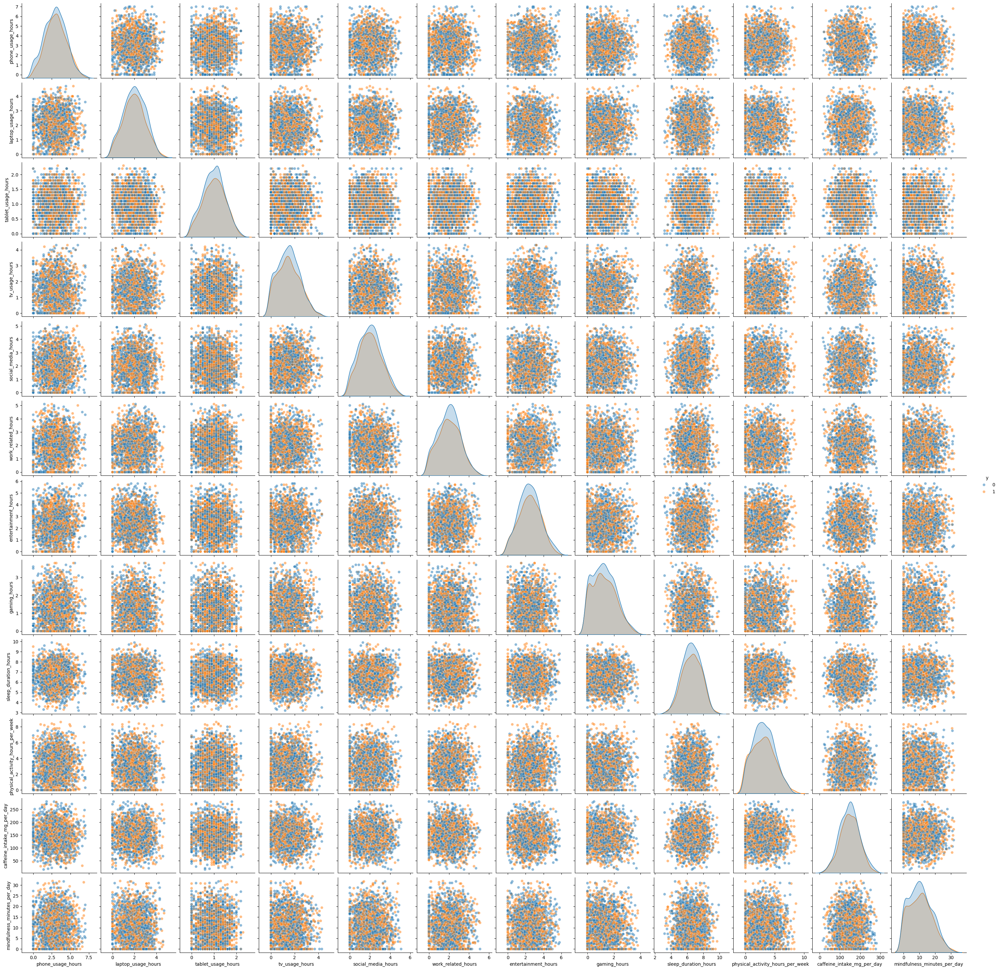

In [17]:
sns.pairplot(data=digital_diet,
             vars=['phone_usage_hours', 'laptop_usage_hours', 'tablet_usage_hours', 'tv_usage_hours', 'social_media_hours', 'work_related_hours', 'entertainment_hours', 'gaming_hours', 'sleep_duration_hours', 'physical_activity_hours_per_week', 'caffeine_intake_mg_per_day', 'mindfulness_minutes_per_day'],
             hue='y',
             plot_kws={"alpha": 0.5});

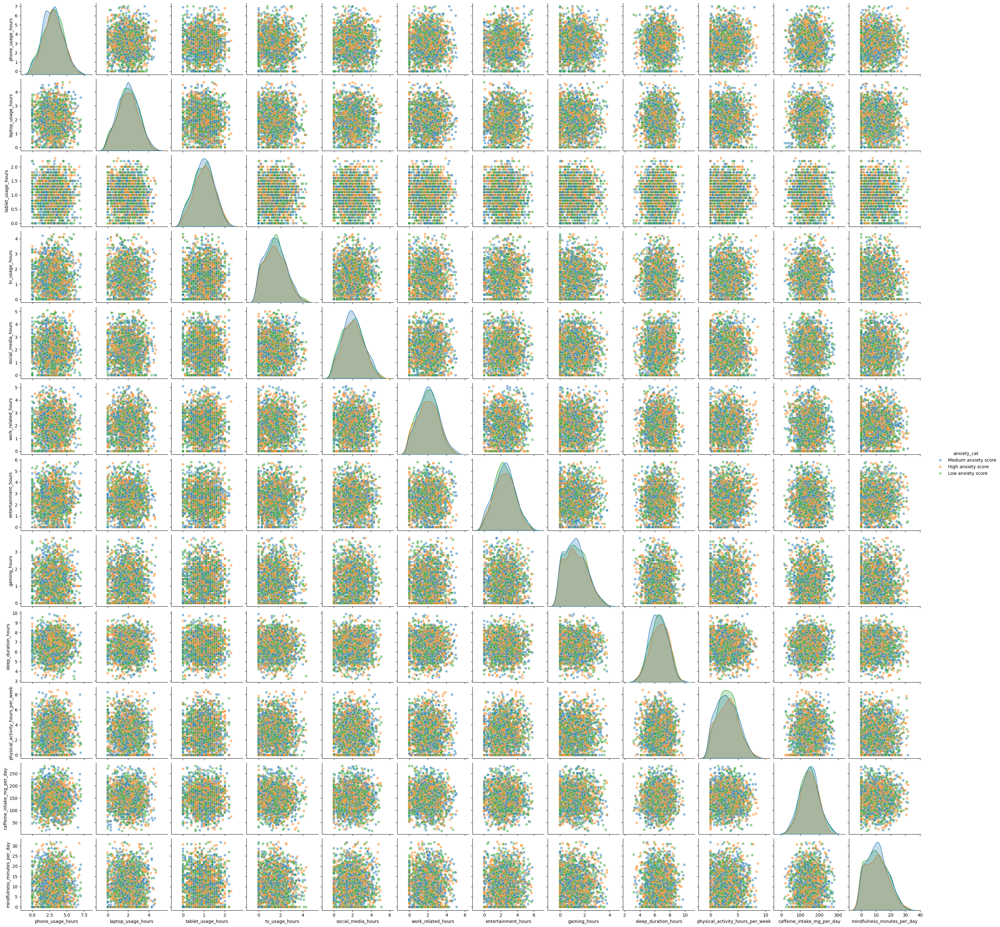

In [18]:
sns.pairplot(data=digital_diet,
             vars=['phone_usage_hours', 'laptop_usage_hours', 'tablet_usage_hours', 'tv_usage_hours', 'social_media_hours', 'work_related_hours', 'entertainment_hours', 'gaming_hours', 'sleep_duration_hours', 'physical_activity_hours_per_week', 'caffeine_intake_mg_per_day', 'mindfulness_minutes_per_day'],
             hue='anxiety_cat',
             plot_kws={"alpha": 0.5});

### Exploring categorical, demographic, boolean features first (5x features)

In [57]:
# Using pandas's `cut` function to "bin" age into groups
# then count number of participants per category
# as well as the average of binary column
# (= "% of people with Low anxiety score")
(
    digital_diet
    .groupby(pd.cut(digital_diet['age'],
                    bins=[10, 25, 40, 55, 70]))
    ['y']
    .agg(['count', 'mean'])
)

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\1698767729.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  .groupby(pd.cut(digital_diet['age'],


,count,mean
age,,
"(10, 25]",465,0.464516
"(25, 40]",543,0.441989
"(40, 55]",569,0.478032
"(55, 70]",338,0.464497


In [20]:
digital_diet.groupby('gender')['y'].agg(['count', 'mean'])

,count,mean
gender,,
Female,892,0.468610
Male,849,0.442874
Other,174,0.522989


In [21]:
digital_diet.groupby('location_type')['y'].agg(['count', 'mean'])

,count,mean
location_type,,
Rural,384,0.484375
Suburban,581,0.461274
Urban,950,0.453684


In [22]:
digital_diet.groupby('uses_wellness_apps')['y'].agg(['count', 'mean'])

,count,mean
uses_wellness_apps,,
0,1166,0.451973
1,749,0.477971


In [23]:
digital_diet.groupby('eats_healthy')['y'].agg(['count', 'mean'])

,count,mean
eats_healthy,,
0,944,0.443856
1,971,0.479918


### <font color='green'> **location_type** & **uses_wellness_apps** have distinguished counts. Candidates for feature selection.

### Next exploring numerical features (12x features)

In [24]:
digital_diet.groupby(pd.cut(digital_diet['phone_usage_hours'], bins=[0,1.75,3.5,5.25,7]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\2175675006.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['phone_usage_hours'], bins=[0,1.75,3.5,5.25,7]))['y'].agg(['count', 'mean'])


,count,mean
phone_usage_hours,,
"(0.0, 1.75]",345,0.428986
"(1.75, 3.5]",863,0.483198
"(3.5, 5.25]",543,0.453039
"(5.25, 7.0]",115,0.539130


In [25]:
digital_diet.groupby(pd.cut(digital_diet['laptop_usage_hours'], bins=[0,1.175,2.35,3.525,4.7]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\4045491738.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['laptop_usage_hours'], bins=[0,1.175,2.35,3.525,4.7]))['y'].agg(['count', 'mean'])


,count,mean
laptop_usage_hours,,
"(0.0, 1.175]",345,0.452174
"(1.175, 2.35]",818,0.474328
"(2.35, 3.525]",589,0.446520
"(3.525, 4.7]",111,0.486486


In [26]:
digital_diet.groupby(pd.cut(digital_diet['tablet_usage_hours'], bins=[0,0.575,1.15,1.725,2.3]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\1337620703.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['tablet_usage_hours'], bins=[0,0.575,1.15,1.725,2.3]))['y'].agg(['count', 'mean'])


,count,mean
tablet_usage_hours,,
"(0.0, 0.575]",304,0.440789
"(0.575, 1.15]",809,0.461063
"(1.15, 1.725]",626,0.471246
"(1.725, 2.3]",114,0.500000


In [27]:
digital_diet.groupby(pd.cut(digital_diet['tv_usage_hours'], bins=[0,1.075,2.15,3.225,4.3]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\2842040741.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['tv_usage_hours'], bins=[0,1.075,2.15,3.225,4.3]))['y'].agg(['count', 'mean'])


,count,mean
tv_usage_hours,,
"(0.0, 1.075]",508,0.462598
"(1.075, 2.15]",784,0.452806
"(2.15, 3.225]",405,0.488889
"(3.225, 4.3]",77,0.428571


In [28]:
digital_diet.groupby(pd.cut(digital_diet['social_media_hours'], bins=[0,1.275,2.55,3.825,5.1]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\446395511.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['social_media_hours'], bins=[0,1.275,2.55,3.825,5.1]))['y'].agg(['count', 'mean'])


,count,mean
social_media_hours,,
"(0.0, 1.275]",435,0.459770
"(1.275, 2.55]",795,0.479245
"(2.55, 3.825]",499,0.464930
"(3.825, 5.1]",108,0.407407


In [29]:
digital_diet.groupby(pd.cut(digital_diet['work_related_hours'], bins=[0,1.275,2.55,3.825,5.1]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\2025103088.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['work_related_hours'], bins=[0,1.275,2.55,3.825,5.1]))['y'].agg(['count', 'mean'])


,count,mean
work_related_hours,,
"(0.0, 1.275]",408,0.460784
"(1.275, 2.55]",805,0.450932
"(2.55, 3.825]",505,0.489109
"(3.825, 5.1]",98,0.459184


In [30]:
digital_diet.groupby(pd.cut(digital_diet['entertainment_hours'], bins=[0,1.45,2.9,4.35,5.8]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\2498321806.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['entertainment_hours'], bins=[0,1.45,2.9,4.35,5.8]))['y'].agg(['count', 'mean'])


,count,mean
entertainment_hours,,
"(0.0, 1.45]",364,0.447802
"(1.45, 2.9]",842,0.457245
"(2.9, 4.35]",533,0.487805
"(4.35, 5.8]",123,0.390244


In [31]:
digital_diet.groupby(pd.cut(digital_diet['gaming_hours'], bins=[0,0.95,1.9,2.85,3.8]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\741337042.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['gaming_hours'], bins=[0,0.95,1.9,2.85,3.8]))['y'].agg(['count', 'mean'])


,count,mean
gaming_hours,,
"(0.0, 0.95]",550,0.470909
"(0.95, 1.9]",725,0.451034
"(1.9, 2.85]",350,0.451429
"(2.85, 3.8]",87,0.471264


In [32]:
digital_diet.groupby(pd.cut(digital_diet['sleep_duration_hours'], bins=[3.2,4.875,6.55,8.225,9.9]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\2678335891.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['sleep_duration_hours'], bins=[3.2,4.875,6.55,8.225,9.9]))['y'].agg(['count', 'mean'])


,count,mean
sleep_duration_hours,,
"(3.2, 4.875]",149,0.442953
"(4.875, 6.55]",798,0.451128
"(6.55, 8.225]",836,0.474880
"(8.225, 9.9]",130,0.476923


In [33]:
digital_diet.groupby(pd.cut(digital_diet['physical_activity_hours_per_week'], bins=[0,2.15,4.3,6.45,8.6]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\360088879.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['physical_activity_hours_per_week'], bins=[0,2.15,4.3,6.45,8.6]))['y'].agg(['count', 'mean'])


,count,mean
physical_activity_hours_per_week,,
"(0.0, 2.15]",524,0.469466
"(2.15, 4.3]",785,0.448408
"(4.3, 6.45]",391,0.437340
"(6.45, 8.6]",89,0.550562


In [34]:
digital_diet.groupby(pd.cut(digital_diet['caffeine_intake_mg_per_day'], bins=[16.3,65.975,131.95,197.925,280.2]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\2368411500.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['caffeine_intake_mg_per_day'], bins=[16.3,65.975,131.95,197.925,280.2]))['y'].agg(['count', 'mean'])


,count,mean
caffeine_intake_mg_per_day,,
"(16.3, 65.975]",88,0.511364
"(65.975, 131.95]",620,0.451613
"(131.95, 197.925]",929,0.468245
"(197.925, 280.2]",277,0.451264


In [35]:
digital_diet.groupby(pd.cut(digital_diet['mindfulness_minutes_per_day'], bins=[0,7.975,15.95,23.925,31.9]))['y'].agg(['count', 'mean'])

C:\Users\benwr\AppData\Local\Temp\ipykernel_1436\650049321.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  digital_diet.groupby(pd.cut(digital_diet['mindfulness_minutes_per_day'], bins=[0,7.975,15.95,23.925,31.9]))['y'].agg(['count', 'mean'])


,count,mean
mindfulness_minutes_per_day,,
"(0.0, 7.975]",552,0.456522
"(7.975, 15.95]",716,0.465084
"(15.95, 23.925]",377,0.440318
"(23.925, 31.9]",87,0.528736


### <font color='green'> **phone_usage_hours**, **caffeine_intake_mg_per_day**, & **mindfulness_minutes_per_day** stand out. Candidates for feature selection.

> ### <font color='green'> All 5 features are distinctively different from each other. Their categories & bin thresholds also have distinguished counts.

---

---

# <font color='green'> Transforming data

### One-hot encode location_type

In [36]:
# location_type has 3 categories 
digital_diet_with_dummies = pd.get_dummies(data=digital_diet,
                                   columns=['location_type'],
                                   drop_first=False
                                  )
# Urban category has the highest count, convention to drop it over others 
digital_diet_with_dummies.drop(['location_type_Urban'],
                        axis=1,
                        inplace=True)
# Inspect result 
digital_diet_with_dummies.head()

,user_id,age,gender,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,entertainment_hours,...,uses_wellness_apps,eats_healthy,caffeine_intake_mg_per_day,weekly_anxiety_score,weekly_depression_score,mindfulness_minutes_per_day,anxiety_cat,y,location_type_Rural,location_type_Suburban
0,user_1,51,Female,3.4,1.3,1.6,1.6,4.1,2.0,1.0,...,1,1,125.2,13,15,4.0,Medium anxiety score,1,False,False
1,user_2,64,Male,3.5,1.8,0.9,2.0,2.7,3.1,1.0,...,0,1,150.4,19,18,6.5,High anxiety score,1,False,True
2,user_3,41,Other,2.1,2.6,0.7,2.2,3.0,2.8,4.1,...,0,0,187.9,7,3,6.9,Medium anxiety score,0,False,True
3,user_4,27,Other,0.0,0.0,0.7,2.5,3.3,1.6,1.3,...,0,1,73.6,7,2,4.8,Medium anxiety score,0,True,False
4,user_5,55,Male,1.7,1.1,1.5,1.6,1.1,3.6,0.8,...,1,1,217.5,8,10,0.0,Medium anxiety score,0,False,False


### Create feature matrix (X), response vector (y), train/test split

In [37]:
feature_cols = ['phone_usage_hours',
                'location_type_Rural', 'location_type_Suburban',
                'uses_wellness_apps',
                'caffeine_intake_mg_per_day',
                'mindfulness_minutes_per_day']

In [38]:
X = digital_diet_with_dummies[feature_cols]
y = digital_diet_with_dummies.y

In [39]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

### Standardization (Note: only for kNN, not RF)

In [40]:
# Instantiate and fit standard scaler 
scaler = StandardScaler()

X_train_knnscaled = scaler.fit_transform(X_train)
X_test_knnscaled = scaler.transform(X_test)

### NOTE: only for kNN, not RF. 

---

---

# <font color='green'> Predictive Modelling: 

### <font color='green'> kNN (first model)

In [41]:
knn = KNeighborsClassifier(n_neighbors=5)

knn.fit(X_train_knnscaled, y_train)

,n_neighbors,5
,weights,'uniform'
,algorithm,'auto'
,leaf_size,30
,p,2
,metric,'minkowski'
,metric_params,None
,n_jobs,None


In [42]:
y_pred_class = knn.predict(X_test_knnscaled)

accuracy_score(y_test, y_pred_class)

0.4906054279749478

In [43]:
y_test.value_counts(normalize=True)

y
0    0.561587
1    0.438413
Name: proportion, dtype: float64

kNN accuracy slightly behind baseline. 

> <font color='green'> kNN **49%** versus baseline **56%**

### Closer look with Confusion matrix, Precision/Recall/F1 score

In [44]:
confusion_matrix(y_test, y_pred_class)

array([[134, 135],
       [109, 101]])

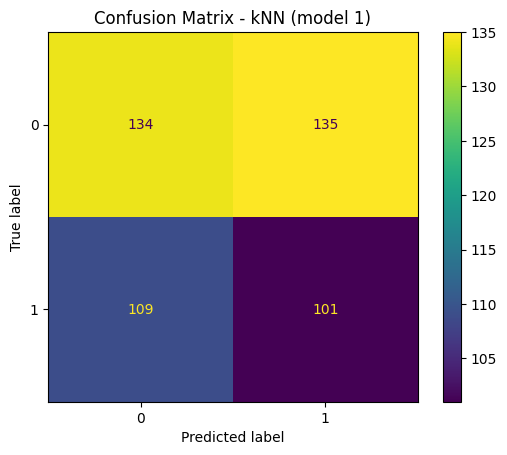

In [45]:
ConfusionMatrixDisplay.from_estimator(knn, X_test_knnscaled, y_test)
plt.title("Confusion Matrix - kNN (model 1)")
plt.show()

In [46]:
print(f"Precision score: {precision_score(y_test, y_pred_class)}")

print(f"Recall score: {recall_score(y_test, y_pred_class)}")

print(f"F1 score: {f1_score(y_test, y_pred_class)}")

Precision score: 0.4279661016949153
Recall score: 0.48095238095238096
F1 score: 0.452914798206278


Relying on only accuracy (49% vs baseline 56%) may be misleading.

<font color='green'> A closer look with the Confusion matrix shows: **Precision score (42%), Recall score (48%), F1 score 45%**. </font>

Now compare with another model.

---

# <font color='green'> Random Forest (second model)

In [47]:
rf_classifier = RandomForestClassifier(n_estimators=120, max_depth=2, class_weight='balanced', random_state=42)

rf_classifier.fit(X_train, y_train)

,n_estimators,120
,criterion,'gini'
,max_depth,2
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,'sqrt'
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


In [48]:
y_pred_class2 = rf_classifier.predict(X_test)

accuracy_score(y_test, y_pred_class2)

0.4989561586638831


> <font color='green'> Random Forest accuracy is **50%** (1% higher ).

### Closer look with Confusion matrix, Precision/Recall/F1 score

In [49]:
confusion_matrix(y_test, y_pred_class2)

array([[112, 157],
       [ 83, 127]])

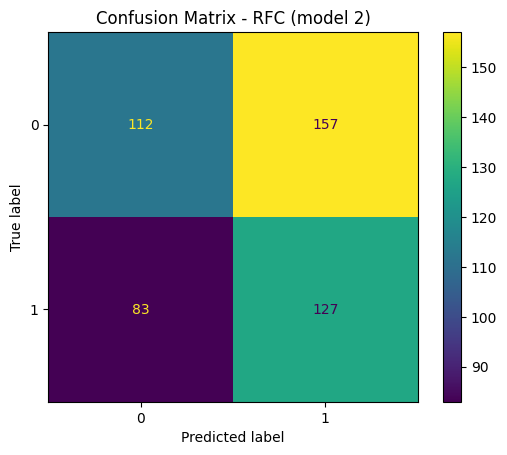

In [50]:
ConfusionMatrixDisplay.from_estimator(rf_classifier, X_test, y_test)
plt.title("Confusion Matrix - RFC (model 2)")
plt.show()

In [51]:
print(f"Precision score: {precision_score(y_test, y_pred_class2)}")

print(f"Recall score: {recall_score(y_test, y_pred_class2)}")

print(f"F1 score: {f1_score(y_test, y_pred_class2)}")

Precision score: 0.4471830985915493
Recall score: 0.6047619047619047
F1 score: 0.5141700404858299


In [54]:
print(f"\nClassification report:\n {classification_report(y_test, y_pred_class2)}")


Classification report:
               precision    recall  f1-score   support

           0       0.57      0.42      0.48       269
           1       0.45      0.60      0.51       210

    accuracy                           0.50       479
   macro avg       0.51      0.51      0.50       479
weighted avg       0.52      0.50      0.50       479



Random Forest made more positive predictions than k-Nearest Neighbors.

> <font color='green'> All 4 scores have improved (Accuracy, Precision, Recall, & F1) </font>

---

# <font color='green'> Comparative analysis

| | Accuracy (baseline 56%) | Precision | Recall | **F1** |
| --- | ---- | ---- | ---- | ---- |
| kNN (model 1) | 49% | 43% | 48% | 45% |
| RFC (model 2) | 50% | **45%** | **60%** | **51%** |

Against a baseline of 56%, both models were slightly behind. Relying only on accuracy can be misleading. Precision & recall score both focus on true positive predictions. F1-score combines them into a single value, providing a balanced assessment of model performance.

<font color='green'> Context-wise, precision & recall are both important. We can also rely on F1-score as a performance indicator.

> **Random Forest outscored k-Nearest Neighbors.**

---

---

# <font color='green'> Performance analysis (with Feature importance)

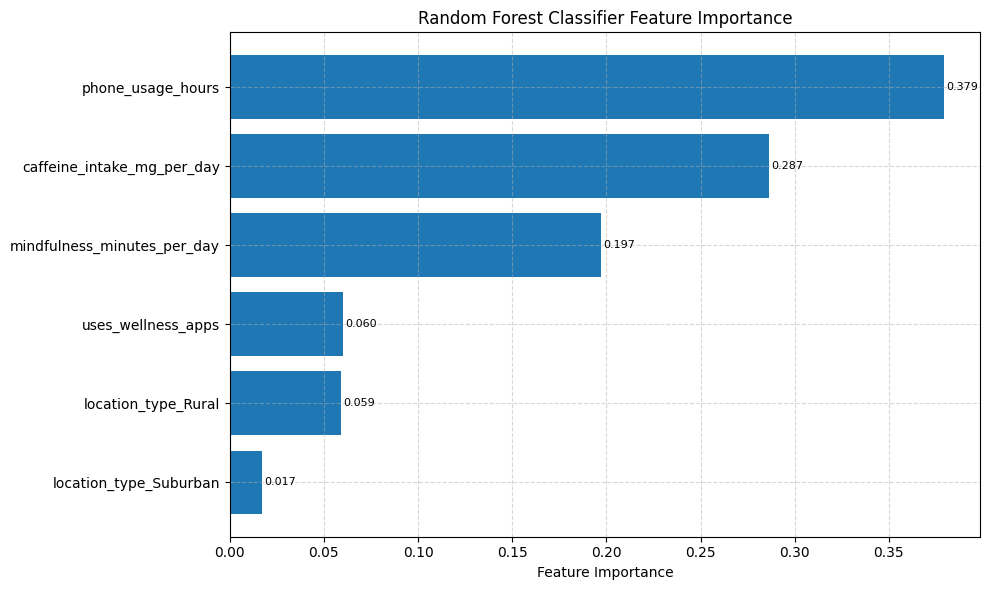

In [ ]:
# Get feature importances from trained model
importances = rf_classifier.feature_importances_
feature_names = X.columns
# Create DataFrame for better visualisation
feat_imp_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)
# Plot 
plt.figure(figsize=(10, 6))
bars = plt.barh(feat_imp_df['Feature'], feat_imp_df['Importance'])
plt.xlabel('Feature Importance')
plt.title('Random Forest Classifier Feature Importance')
plt.gca().invert_yaxis()  # Highest on top
plt.grid(True, linestyle='--', alpha=0.5)
# Add value labels to bars
for bar in bars:
    width = bar.get_width()
    plt.text(width + 0.001, bar.get_y() + bar.get_height()/2,
             f"{width:.3f}", va='center', fontsize=8)
plt.tight_layout()
plt.show()

> <font color='green'> **Phone usage**, **caffeine intake**, and **mindfulness minutes** contributed the most to model performance & efficiency (by more than 86%). Wellness app usage came in next.

---

---

### For Power BI dashboard visuals:

In [ ]:
digital_diet.head()

,user_id,age,gender,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,entertainment_hours,...,location_type,mental_health_score,uses_wellness_apps,eats_healthy,caffeine_intake_mg_per_day,weekly_anxiety_score,weekly_depression_score,mindfulness_minutes_per_day,anxiety_cat,y
0,user_1,51,Female,3.4,1.3,1.6,1.6,4.1,2.0,1.0,...,Urban,32,1,1,125.2,13,15,4.0,Medium anxiety score,1
1,user_2,64,Male,3.5,1.8,0.9,2.0,2.7,3.1,1.0,...,Suburban,75,0,1,150.4,19,18,6.5,High anxiety score,1
2,user_3,41,Other,2.1,2.6,0.7,2.2,3.0,2.8,4.1,...,Suburban,22,0,0,187.9,7,3,6.9,Medium anxiety score,0
3,user_4,27,Other,0.0,0.0,0.7,2.5,3.3,1.6,1.3,...,Rural,22,0,1,73.6,7,2,4.8,Medium anxiety score,0
4,user_5,55,Male,1.7,1.1,1.5,1.6,1.1,3.6,0.8,...,Urban,64,1,1,217.5,8,10,0.0,Medium anxiety score,0


In [ ]:
digital_diet.describe()

,age,phone_usage_hours,laptop_usage_hours,tablet_usage_hours,tv_usage_hours,social_media_hours,work_related_hours,entertainment_hours,gaming_hours,sleep_duration_hours,...,stress_level,physical_activity_hours_per_week,mental_health_score,uses_wellness_apps,eats_healthy,caffeine_intake_mg_per_day,weekly_anxiety_score,weekly_depression_score,mindfulness_minutes_per_day,y
count,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,...,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000,1915.000000
mean,38.781201,2.995666,1.986684,0.991018,1.495248,2.024073,1.996397,2.449138,1.259896,6.543238,...,5.560836,3.072846,49.703916,0.391123,0.507050,147.908094,9.831332,10.038642,10.697650,0.462141
std,14.921658,1.429389,0.983572,0.487024,0.942253,1.109944,1.102094,1.226694,0.874777,1.179966,...,2.900624,1.867302,17.560243,0.488129,0.500081,47.330025,6.031809,6.033481,7.247212,0.498695
min,13.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.200000,...,1.000000,0.000000,20.000000,0.000000,0.000000,16.300000,0.000000,0.000000,0.000000,0.000000
25%,26.000000,2.000000,1.300000,0.600000,0.800000,1.200000,1.200000,1.600000,0.600000,5.700000,...,3.000000,1.600000,35.000000,0.000000,0.000000,114.550000,5.000000,5.000000,4.950000,0.000000
50%,39.000000,3.000000,2.000000,1.000000,1.500000,2.000000,2.000000,2.400000,1.200000,6.600000,...,6.000000,3.000000,49.000000,0.000000,1.000000,147.500000,10.000000,10.000000,10.400000,0.000000
75%,51.000000,4.000000,2.700000,1.300000,2.200000,2.800000,2.800000,3.300000,1.900000,7.400000,...,8.000000,4.400000,65.000000,1.000000,1.000000,179.750000,15.000000,15.000000,15.750000,1.000000
max,64.000000,7.000000,4.700000,2.300000,4.300000,5.100000,5.100000,5.800000,3.800000,9.900000,...,10.000000,8.600000,80.000000,1.000000,1.000000,280.200000,20.000000,20.000000,31.900000,1.000000


In [ ]:
# digital_diet.to_csv('digital_diet_viz.csv')

---

---